In [1]:
import pandas as pd
import datetime
from matplotlib import pyplot as plt
import seaborn as sns
import numpy as np
import folium
from folium import PolyLine, CircleMarker
from folium.plugins import HeatMap
import geopandas as gpd
from shapely.geometry import Point
from branca.element import Template, MacroElement

sns.set()

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [2]:
# Read data
df = pd.read_csv("/kaggle/input/earthquake/earthquake.csv")
df_2 = pd.read_csv("/kaggle/input/earthquake/earthquake_damage.csv")
tectonic_plates = pd.read_csv("../input/tectonic-plate-boundaries/all.csv" )

# Tổng quan các trận động đất tại Nhật Bản trong giai đoạn 2000 - 2022

In [3]:
def preprocess(df):
    df['time'] =  pd.to_datetime(df["time"])
    df['year'] = df['time'].dt.year
    df['month'] = df['time'].dt.month
    df['day'] = df['time'].dt.day
    df['hour'] = df['time'].dt.hour

In [4]:
preprocess(df)

In [5]:
df.shape

(28366, 26)

In [6]:
df.describe()

,latitude,longitude,depth,mag,nst,gap,dmin,rms,horizontalError,depthError,magError,magNst,year,month,day,hour
count,28366.000000,28366.000000,28366.000000,28366.000000,19391.000000,25466.000000,9770.000000,27498.000000,8592.000000,19489.000000,9615.000000,23581.000000,28366.000000,28366.000000,28366.000000,28366.000000
mean,34.285144,139.562607,67.724255,4.475452,63.441803,117.317239,1.883527,0.851909,7.377202,8.466086,0.124213,28.648022,2011.095431,6.284496,15.761792,11.636537
std,5.145011,5.199937,102.499916,0.448096,88.454475,41.005881,1.215619,0.244908,2.361584,7.085815,0.070877,51.659423,6.104249,3.415708,8.498233,6.937328
min,23.650300,123.355000,0.000000,2.700000,4.000000,8.000000,0.038000,0.040000,1.400000,0.000000,0.021000,1.000000,2000.000000,1.000000,1.000000,0.000000
25%,29.944650,139.207250,14.200000,4.200000,17.000000,94.000000,1.069000,0.690000,5.900000,4.400000,0.072000,4.000000,2007.000000,3.000000,9.000000,6.000000
50%,35.611450,141.540600,35.000000,4.400000,31.000000,122.000000,1.720000,0.840000,7.200000,6.900000,0.110000,11.000000,2011.000000,6.000000,15.000000,12.000000
75%,37.834000,142.634175,57.900000,4.700000,66.000000,136.100000,2.484000,1.000000,8.600000,10.300000,0.160000,28.000000,2015.000000,9.000000,23.000000,18.000000
max,45.789000,145.986000,686.390000,9.100000,929.000000,353.400000,33.409000,1.940000,25.600000,72.700000,0.610000,761.000000,2023.000000,12.000000,31.000000,23.000000


In [7]:
df.isnull().sum()

time                   0
latitude               0
longitude              0
depth                  0
mag                    0
magType                0
nst                 8975
gap                 2900
dmin               18596
rms                  868
net                    0
id                     0
updated                0
place                  0
type                   0
horizontalError    19774
depthError          8877
magError           18751
magNst              4785
status                 0
locationSource         0
magSource              0
year                   0
month                  0
day                    0
hour                   0
dtype: int64

Text(0.5, 1.0, 'Biểu đồ số trận động đất theo năm ở Nhật Bản\n Trung bình: 1092')

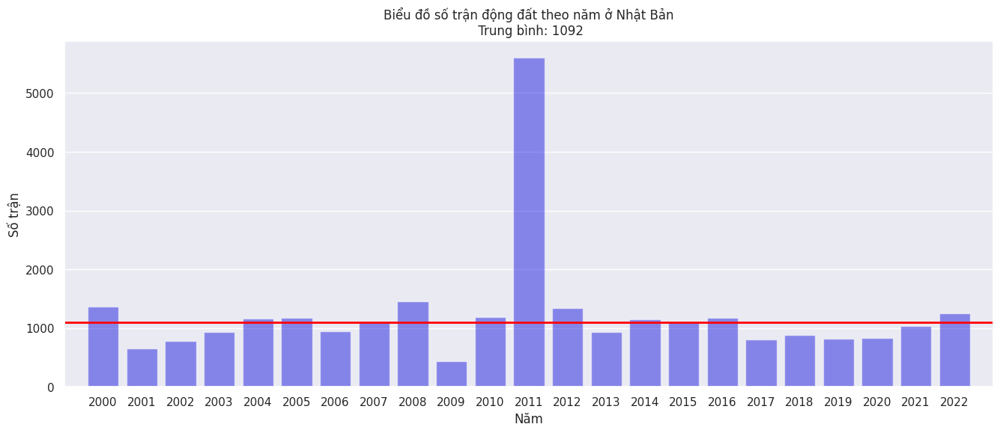

In [8]:
df_year_count = pd.DataFrame(data=df[df["year"] < 2023].groupby("year").place.count()).reset_index()
median = np.median(df_year_count["place"])

plt.figure(figsize=(16,6))
ax = sns.barplot(x=df_year_count["year"], y=df_year_count["place"], color="blue", alpha=0.5)
ax.set(xlabel='Năm', ylabel='Số trận')
plt.hlines(y=median, xmin=-1, xmax=24, color="red", linewidth=2)
plt.xlim([-1,23])
median = int(median)
plt.title("Biểu đồ số trận động đất theo năm ở Nhật Bản\n Trung bình: {}".format(median))

In [9]:
# Magnitude Classification
df.loc[df["mag"] < 3, "mag_cls"] = "2.0 - 2.9"
df.loc[(df["mag"] >= 3) & (df["mag"] < 4), "mag_cls"] = "3.0 - 3.9"
df.loc[(df["mag"] >= 4) & (df["mag"] < 5), "mag_cls"] = "4.0 - 4.9"
df.loc[(df["mag"] >= 5) & (df["mag"] < 6), "mag_cls"] = "5.0 - 5.9"
df.loc[(df["mag"] >= 6) & (df["mag"] < 7), "mag_cls"] = "6.0 - 6.9"
df.loc[(df["mag"] >= 7) & (df["mag"] < 8), "mag_cls"] = "7.0 - 7.9"
df.loc[(df["mag"] >= 8) & (df["mag"] < 9), "mag_cls"] = "8.0 - 8.9"
df.loc[df["mag"] >= 9, "mag_cls"] = ">= 9.0"

Text(0.5, 1.0, 'Biểu đồ phân bố các trận động đất theo cường độ trong giai đoạn 2000 - 2022')

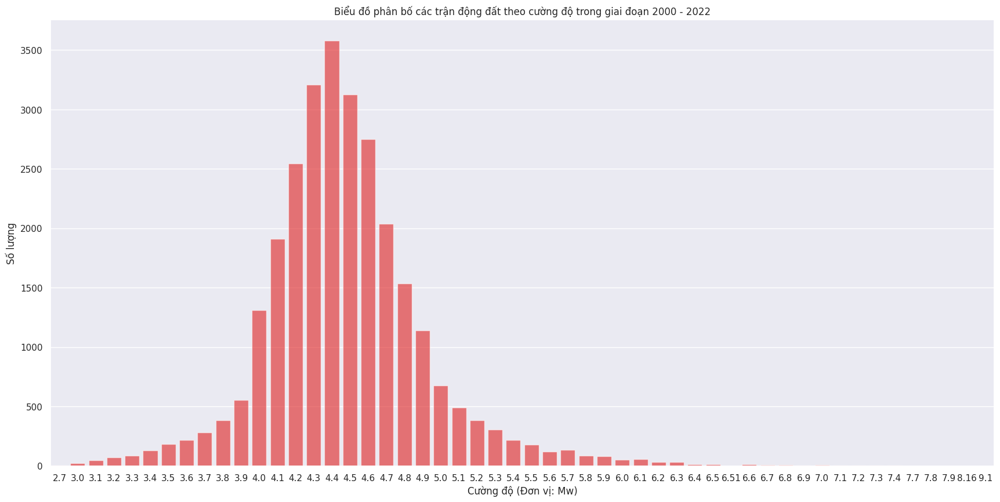

In [10]:
# Biểu đồ phân bố các trận động đất theo cường độ trong giai đoạn 2000 - 2022
plt.figure(figsize=(21,10))
sns.countplot(x=df[df["year"] < 2023]["mag"], color="red", alpha=0.6)
plt.xlabel("Cường độ (Đơn vị: Mw)")
plt.ylabel("Số lượng")
plt.title("Biểu đồ phân bố các trận động đất theo cường độ trong giai đoạn 2000 - 2022")

Text(0.5, 1.0, 'Biểu đồ phân bố các trận động đất theo cường độ trong giai đoạn 2000 - 2022')

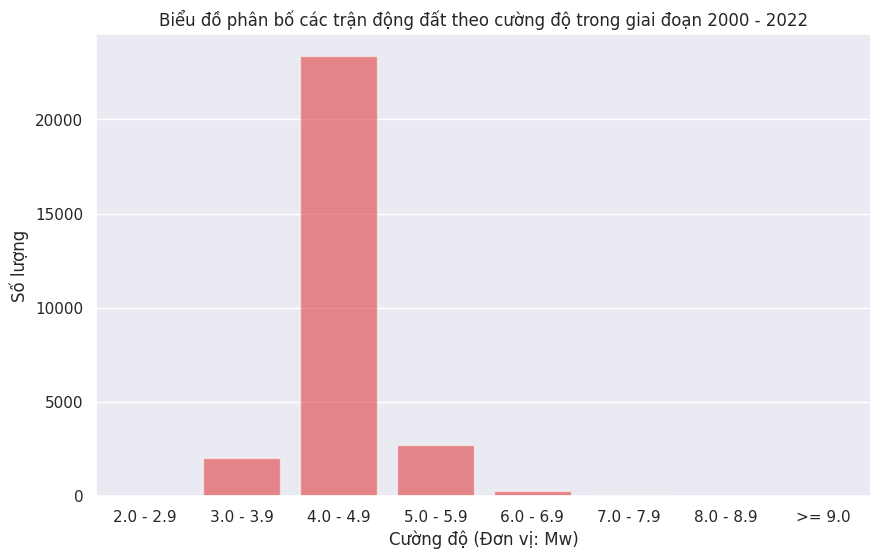

In [11]:
# Biểu đồ phân bố các trận động đất theo cường độ trong giai đoạn 2000 - 2022
plt.figure(figsize=(10,6))
sns.countplot(x=df["mag_cls"], color="red", alpha=0.5, order=["2.0 - 2.9", "3.0 - 3.9", 
                                                              "4.0 - 4.9", "5.0 - 5.9", 
                                                              "6.0 - 6.9", "7.0 - 7.9",
                                                              "8.0 - 8.9", ">= 9.0"])
plt.xlabel("Cường độ (Đơn vị: Mw)")
plt.ylabel("Số lượng")
plt.title("Biểu đồ phân bố các trận động đất theo cường độ trong giai đoạn 2000 - 2022")

/tmp/ipykernel_34/3907670789.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[df["year"] < 2023]["depth"], color="green")


Text(0.5, 1.0, 'Biểu đồ phân bố các trận động đất theo độ sâu trong giai đoạn 2000-2022')

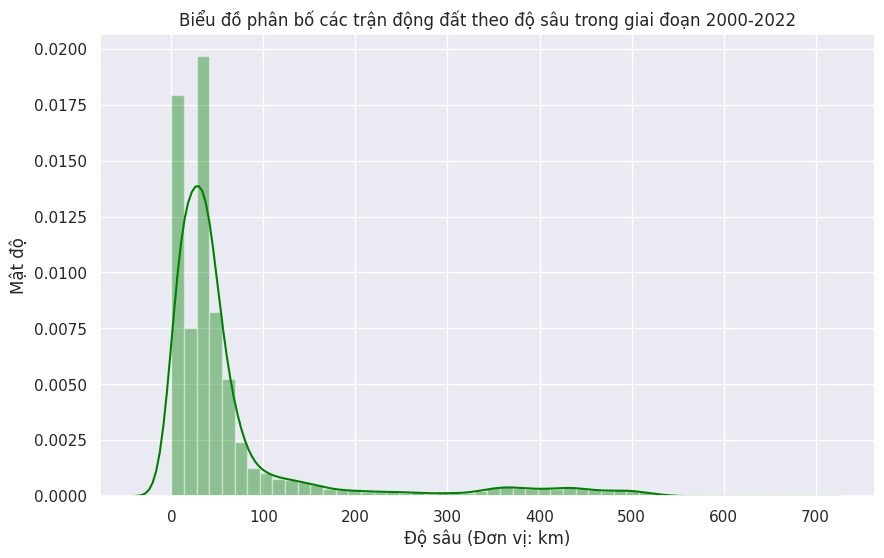

In [12]:
# Biểu đồ phân bố các trận động đất theo độ sâu trong giai đoạn 2000-2022
plt.figure(figsize=(10,6))
sns.distplot(df[df["year"] < 2023]["depth"], color="green")
mean_depth = df[df["year"] < 2023]["depth"].mean()
plt.xlabel("Độ sâu (Đơn vị: km)")
plt.ylabel("Mật độ")
plt.title("Biểu đồ phân bố các trận động đất theo độ sâu trong giai đoạn 2000-2022")

/tmp/ipykernel_34/4119688312.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[df["year"] < 2023].query("depth < 70")["mag"], color="green")
/tmp/ipykernel_34/4119688312.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[df["year"] < 2023].query("depth >= 70 & depth < 300")["mag"], colo

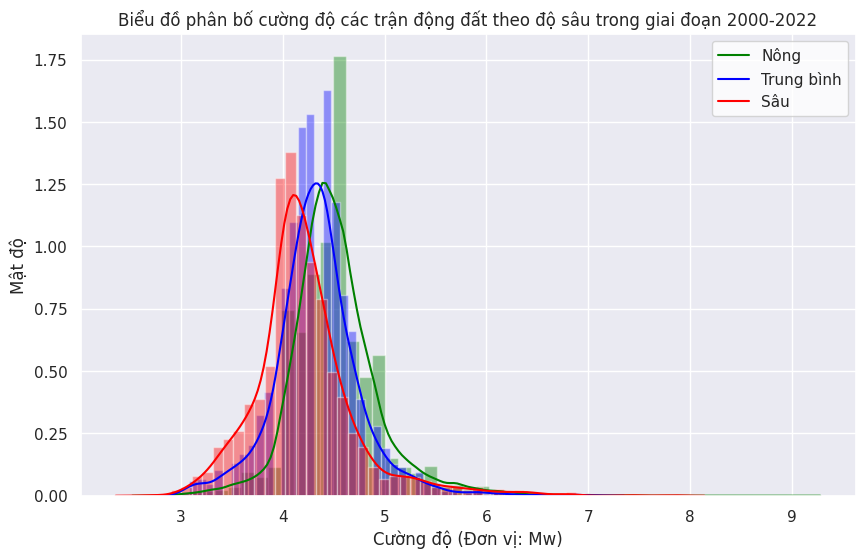

In [13]:
# Biểu đồ phân bố cường độ các trận động đất theo độ sâu trong giai đoạn 2000-2022
plt.figure(figsize=(10,6))
sns.distplot(df[df["year"] < 2023].query("depth < 70")["mag"], color="green")
sns.distplot(df[df["year"] < 2023].query("depth >= 70 & depth < 300")["mag"], color="blue")
sns.distplot(df[df["year"] < 2023].query("depth >= 300")["mag"], color="red")

plt.xlabel("Cường độ (Đơn vị: Mw)")
plt.ylabel("Mật độ")
plt.title("Biểu đồ phân bố cường độ các trận động đất theo độ sâu trong giai đoạn 2000-2022")
plt.legend(["Nông", "Trung bình", "Sâu"], facecolor="white")

In [14]:
# Bản đồ phân bố các trận động đất theo độ sâu trong giai đoạn 2000-2022
m_1 = folium.Map(location=[37, 138],tiles='Stamen Terrain', zoom_start=5)

mapping_70 = pd.DataFrame({
    'place':df.query("depth < 70")["place"].values,
    'data':df.query("depth < 70")["mag"].values,
    'lat':df.query("depth < 70")["latitude"].values,
    'lon':df.query("depth < 70")["longitude"].values
})

mapping_300 = pd.DataFrame({
    'place':df.query("depth >= 70 & depth < 300")["place"].values,
    'data':df.query("depth >= 70 & depth < 300")["mag"].values,
    'lat':df.query("depth >= 70 & depth < 300")["latitude"].values,
    'lon':df.query("depth >= 70 & depth < 300")["longitude"].values
})

mapping_700 = pd.DataFrame({
    'place':df.query("depth >= 300 & depth < 700")["place"].values,
    'data':df.query("depth >= 300 & depth < 700")["mag"].values,
    'lat':df.query("depth >= 300 & depth < 700")["latitude"].values,
    'lon':df.query("depth >= 300 & depth < 700")["longitude"].values
})


for i, r in mapping_70.iterrows():
    CircleMarker(location=[r["lat"],r["lon"]], radius=r["data"]/20, popup=r["place"], color='green').add_to(m_1)
    
for i, r in mapping_300.iterrows():
    CircleMarker(location=[r["lat"],r["lon"]], radius=r["data"]/20, popup=r["place"], color='blue').add_to(m_1)
    
for i, r in mapping_700.iterrows():
    CircleMarker(location=[r["lat"],r["lon"]], radius=r["data"]/20, popup=r["place"], color='red').add_to(m_1)
    
plates = list(tectonic_plates["plate"].unique())
for plate in plates:
    plate_vals = tectonic_plates[tectonic_plates["plate"] == plate]
    lats = plate_vals["lat"].values
    lons = plate_vals["lon"].values
    points = list(zip(lats, lons))
    indexes = [None] + [i + 1 for i, x in enumerate(points) if i < len(points) - 1 and abs(x[1] - points[i + 1][1]) > 300] + [None]
    for i in range(len(indexes) - 1):
        folium.vector_layers.PolyLine(points[indexes[i]:indexes[i+1]], popup=plate, color="#58508d", fill=False, ).add_to(m_1)
        
template = """
{% macro html(this, kwargs) %}

<!doctype html>
<html lang="en">
<head>
  <meta charset="utf-8">
  <meta name="viewport" content="width=device-width, initial-scale=1">
  <title>jQuery UI Draggable - Default functionality</title>
  <link rel="stylesheet" href="//code.jquery.com/ui/1.12.1/themes/base/jquery-ui.css">

  <script src="https://code.jquery.com/jquery-1.12.4.js"></script>
  <script src="https://code.jquery.com/ui/1.12.1/jquery-ui.js"></script>

</head>
<body>

 
<div id='maplegend' class='maplegend' 
    style='position: absolute; z-index:9999; border:2px solid grey; background-color:rgba(255, 255, 255, 0.8);
     border-radius:6px; padding: 10px; font-size:14px; right: 20px; bottom: 20px;'>
     
<div class='legend-title'>Độ sâu (Đơn vị: km)</div>
<div class='legend-scale'>
  <ul class='legend-labels'>
    <li><span style='background:green;opacity:1;'></span> 0 - 69</li>
    <li><span style='background:blue;opacity:1;'></span> 70 - 299</li>
    <li><span style='background:red;opacity:1;'></span> >= 300</li>

  </ul>
</div>
</div>
 
</body>
</html>

<style type='text/css'>
  .maplegend .legend-title {
    text-align: left;
    margin-bottom: 5px;
    font-weight: bold;
    font-size: 90%;
    }
  .maplegend .legend-scale ul {
    margin: 0;
    margin-bottom: 5px;
    padding: 0;
    float: left;
    list-style: none;
    }
  .maplegend .legend-scale ul li {
    font-size: 80%;
    list-style: none;
    margin-left: 0;
    line-height: 18px;
    margin-bottom: 2px;
    }
  .maplegend ul.legend-labels li span {
    display: block;
    float: left;
    height: 16px;
    width: 30px;
    margin-right: 5px;
    margin-left: 0;
    border: 1px solid #999;
    }
  .maplegend .legend-source {
    font-size: 80%;
    color: #777;
    clear: both;
    }
  .maplegend a {
    color: #777;
    }
</style>
{% endmacro %}"""

macro = MacroElement()
macro._template = Template(template)

m_1.get_root().add_child(macro)

m_1.save("depth.html")

m_1

# Tổng quan thiệt hại các trận động đất tại Nhật Bản trong giai đoạn 2000 - 2022

In [15]:
df_2['geometry'] = df_2.apply(lambda row:  Point(row["Longitude"], row["Latitude"]), axis=1)
df_2 = gpd.GeoDataFrame(df_2, geometry=df_2.geometry )
df_2.head()

/opt/conda/lib/python3.10/site-packages/pandas/core/dtypes/cast.py:127: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  arr = construct_1d_object_array_from_listlike(values)


,Unnamed: 0,Year,Month,Day,Hour,Min,Sec,Tsu,Vol,Location Name,...,Total Injuries,Total Injuries Description,Total Damage ($Mil),Total Damage Description,Total Houses Destroyed,Total Houses Destroyed Description,Total Houses Damaged,Total Houses Damaged Description,Tsunami,geometry
0,0,2000,3,28,11,0,22.5,NaN,NaN,VOLCANO ISLANDS,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (143.73000 22.33800)
1,1,2000,7,1,7,1,55.5,2340.0,5104.0,NEAR S COAST HONSHU: KOZU-SHIMA,...,NaN,3.0,NaN,1.0,NaN,NaN,NaN,NaN,1.0,POINT (139.13100 34.22100)
2,2,2000,7,15,1,30,30.5,3508.0,NaN,NEAR S COAST HONSHU: NII-JIMA,...,10.0,1.0,NaN,1.0,NaN,NaN,20.0,1.0,1.0,POINT (139.26000 34.31900)
3,3,2000,7,30,12,25,45.5,3509.0,NaN,HONSHU: S,...,1.0,1.0,NaN,1.0,NaN,NaN,NaN,NaN,1.0,POINT (139.37600 33.90100)
4,4,2000,10,6,4,30,19.1,NaN,NaN,"HONSHU: W: OKAYAMA, TOTTORI",...,130.0,3.0,150.0,4.0,104.0,3.0,2230.0,4.0,NaN,POINT (133.13400 35.45600)


In [16]:
df_2['Total Deaths'] = df_2['Total Deaths'].fillna(0).astype('int')
df_2['Total Injuries'] = df_2['Total Injuries'].fillna(0).astype('int')
df_2['Total Houses Destroyed'] = df_2['Total Houses Destroyed'].fillna(0).astype('int')
df_2['Total Houses Damaged'] = df_2['Total Houses Damaged'].fillna(0).astype('int')
df_2['Total Houses Attacked'] = df_2['Total Houses Damaged'] + df_2['Total Houses Destroyed']
df_2['Tsunami'] = df_2['Tsunami'].fillna(0).astype('int')
df_2.loc[:, ['Latitude', 'Longitude', 'Total Deaths', 'Total Injuries', 'Total Houses Attacked',
             'Tsunami']]

,Latitude,Longitude,Total Deaths,Total Injuries,Total Houses Attacked,Tsunami
0,22.338,143.730,0,0,0,0
1,34.221,139.131,1,0,0,1
2,34.319,139.260,0,10,20,1
3,33.901,139.376,0,1,0,1
4,35.456,133.134,0,130,2334,0
...,...,...,...,...,...,...
68,38.646,139.472,0,28,144,1
69,37.745,141.749,1,186,20556,0
70,38.452,141.648,0,11,0,0
71,37.702,141.587,4,247,56935,0


In [17]:
df_human = pd.DataFrame(data=df_2[(df_2["Total Deaths"] > 0) |
                                  (df_2["Total Injuries"] > 0)].groupby("Mag")["Total Deaths"].mean()).sort_values(by=['Mag'])
df_human["Total Deaths"] = round(df_human["Total Deaths"]).astype('int')
df_human["Total Injuries"] = round(df_2[df_2["Total Injuries"] > 0].groupby("Mag")["Total Injuries"].mean()).astype('int')
df_human["count"] = df_2[(df_2["Total Deaths"] > 0) |
                         (df_2["Total Injuries"] > 0)].groupby("Mag")["Total Deaths"].count()
df_human = df_human.reset_index()
df_human

,Mag,Total Deaths,Total Injuries,count
0,4.6,0,12,1
1,4.9,0,7,1
2,5.5,2,331,3
3,5.7,0,8,2
4,5.8,0,10,3
5,5.9,0,16,2
6,6.1,0,10,2
7,6.2,0,29,3
8,6.3,0,13,2
9,6.4,0,76,2


Text(0.5, 1.0, 'Biểu đồ phân bố các trận động đất gây thiệt hại về người theo cường độ trong giai đoạn 2000 - 2022')

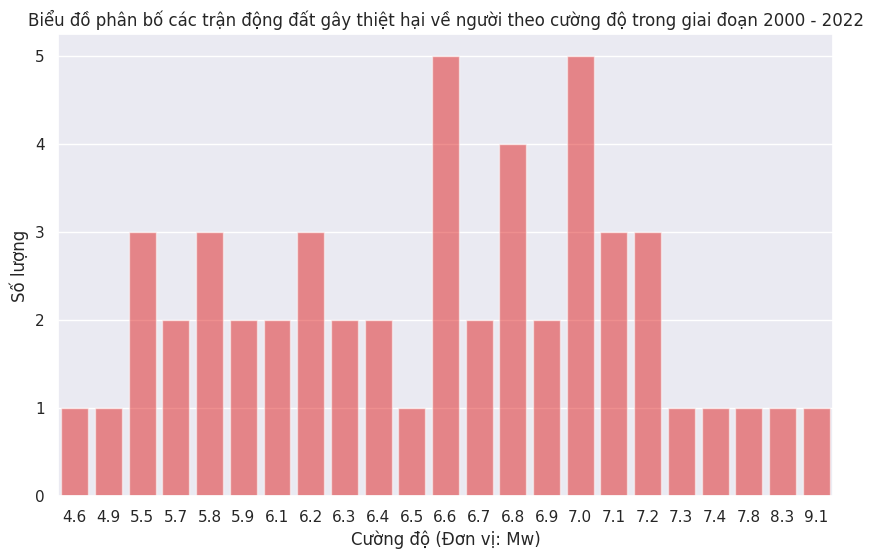

In [18]:
# Biểu đồ phân bố các trận động đất gây thiệt hại về người theo cường độ trong giai đoạn 2000 - 2022
plt.figure(figsize=(10,6))
sns.barplot(x=df_human['Mag'], y=df_human['count'], color="red", alpha=0.5)

plt.xlabel("Cường độ (Đơn vị: Mw)")
plt.ylabel("Số lượng")
plt.title("Biểu đồ phân bố các trận động đất gây thiệt hại về người theo cường độ trong giai đoạn 2000 - 2022")

In [19]:
# Magnitude Classification
df_2.loc[df_2["Mag"] < 3, "mag_cls"] = "2.0 - 2.9"
df_2.loc[(df_2["Mag"] >= 3) & (df_2["Mag"] < 4), "mag_cls"] = "3.0 - 3.9"
df_2.loc[(df_2["Mag"] >= 4) & (df_2["Mag"] < 5), "mag_cls"] = "4.0 - 4.9"
df_2.loc[(df_2["Mag"] >= 5) & (df_2["Mag"] < 6), "mag_cls"] = "5.0 - 5.9"
df_2.loc[(df_2["Mag"] >= 6) & (df_2["Mag"] < 7), "mag_cls"] = "6.0 - 6.9"
df_2.loc[(df_2["Mag"] >= 7) & (df_2["Mag"] < 8), "mag_cls"] = "7.0 - 7.9"
df_2.loc[(df_2["Mag"] >= 8) & (df_2["Mag"] < 9), "mag_cls"] = "8.0 - 8.9"
df_2.loc[df_2["Mag"] >= 9, "mag_cls"] = ">= 9.0"

Text(0.5, 1.0, 'Biểu đồ phân bố các trận động đất gây thiệt hại về người theo cường độ trong giai đoạn 2000 - 2022')

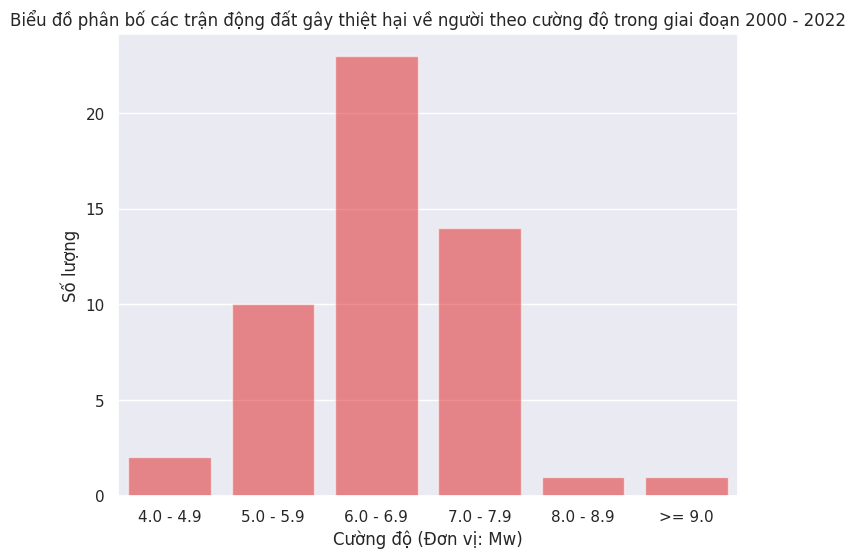

In [20]:
# Biểu đồ phân bố các trận động đất gây thiệt hại về người theo cường độ trong giai đoạn 2000 - 2022
plt.figure(figsize=(8,6))
sns.countplot(x=df_2.loc[(df_2["Total Deaths"] > 0) | (df_2["Total Injuries"] > 0), "mag_cls"],
              color="red", alpha=0.5, order=["4.0 - 4.9", "5.0 - 5.9", "6.0 - 6.9", "7.0 - 7.9",
                                             "8.0 - 8.9", ">= 9.0"])
plt.xlabel("Cường độ (Đơn vị: Mw)")
plt.ylabel("Số lượng")
plt.title("Biểu đồ phân bố các trận động đất gây thiệt hại về người theo cường độ trong giai đoạn 2000 - 2022")

In [21]:
def get_color(magnitude):
    if magnitude < 5:
        return 'green'
    elif magnitude < 6:
        return 'blue'
    elif magnitude < 7:
        return 'yellow'
    elif magnitude < 8:
        return 'orange'
    else:
        return 'red'

In [22]:
# Bản đồ phân bố số lượng người thiệt mạng trong các cơn động đất tại NB trong giai đoạn 2000-2022
m_2 = folium.Map(location=[37, 138],tiles='Stamen Terrain', zoom_start=5)
HeatMap(df_2[df_2['Total Deaths'] > 0].loc[:, ['Latitude', 'Longitude', 'Total Deaths']],
        gradient={0.4: 'blue', 0.65: 'lime', 1: 'red'}).add_to(m_2)
for i, row in df_2[df_2['Total Deaths'] > 0].iterrows():
    folium.Circle(location=(row.geometry.y, row.geometry.x), color=get_color(row.Mag),
                  radius=10000).add_to(m_2)

template = """
{% macro html(this, kwargs) %}

<!doctype html>
<html lang="en">
<head>
  <meta charset="utf-8">
  <meta name="viewport" content="width=device-width, initial-scale=1">
  <title>jQuery UI Draggable - Default functionality</title>
  <link rel="stylesheet" href="//code.jquery.com/ui/1.12.1/themes/base/jquery-ui.css">

  <script src="https://code.jquery.com/jquery-1.12.4.js"></script>
  <script src="https://code.jquery.com/ui/1.12.1/jquery-ui.js"></script>

</head>
<body>

 
<div id='maplegend' class='maplegend' 
    style='position: absolute; z-index:9999; border:2px solid grey; background-color:rgba(255, 255, 255, 0.8);
     border-radius:6px; padding: 10px; font-size:14px; right: 20px; bottom: 20px;'>
     
<div class='legend-title'>Cường độ</div>
<div class='legend-scale'>
  <ul class='legend-labels'>
    <li><span style='background:green;opacity:1;'></span> 0 - 4.9</li>
    <li><span style='background:blue;opacity:1;'></span> 5.0 - 5.9</li>
    <li><span style='background:yellow;opacity:1;'></span> 6.0 - 6.9</li>
    <li><span style='background:orange;opacity:1;'></span> 7.0 - 7.9</li>
    <li><span style='background:red;opacity:1;'></span> >= 8.0</li>

  </ul>
</div>
</div>
 
</body>
</html>

<style type='text/css'>
  .maplegend .legend-title {
    text-align: left;
    margin-bottom: 5px;
    font-weight: bold;
    font-size: 90%;
    }
  .maplegend .legend-scale ul {
    margin: 0;
    margin-bottom: 5px;
    padding: 0;
    float: left;
    list-style: none;
    }
  .maplegend .legend-scale ul li {
    font-size: 80%;
    list-style: none;
    margin-left: 0;
    line-height: 18px;
    margin-bottom: 2px;
    }
  .maplegend ul.legend-labels li span {
    display: block;
    float: left;
    height: 16px;
    width: 30px;
    margin-right: 5px;
    margin-left: 0;
    border: 1px solid #999;
    }
  .maplegend .legend-source {
    font-size: 80%;
    color: #777;
    clear: both;
    }
  .maplegend a {
    color: #777;
    }
</style>
{% endmacro %}"""

macro = MacroElement()
macro._template = Template(template)

m_2.get_root().add_child(macro)

m_2.save("death.html")
m_2

In [23]:
# Bản đồ phân bố số lượng người bị thương trong các cơn động đất tại NB trong giai đoạn 2000-2022
m_3 = folium.Map(location=[37, 138],tiles='Stamen Terrain', zoom_start=5)
HeatMap(df_2[df_2['Total Injuries'] > 0].loc[:, ['Latitude', 'Longitude', 'Total Injuries']],
        gradient={0.4: 'blue', 0.65: 'lime', 1: 'red'}).add_to(m_3)
for i, row in df_2[df_2['Total Injuries'] > 0].iterrows():
    folium.Circle(location=(row.geometry.y, row.geometry.x), color=get_color(row.Mag),
                  radius=10000).add_to(m_3)

template = """
{% macro html(this, kwargs) %}

<!doctype html>
<html lang="en">
<head>
  <meta charset="utf-8">
  <meta name="viewport" content="width=device-width, initial-scale=1">
  <title>jQuery UI Draggable - Default functionality</title>
  <link rel="stylesheet" href="//code.jquery.com/ui/1.12.1/themes/base/jquery-ui.css">

  <script src="https://code.jquery.com/jquery-1.12.4.js"></script>
  <script src="https://code.jquery.com/ui/1.12.1/jquery-ui.js"></script>

</head>
<body>

 
<div id='maplegend' class='maplegend' 
    style='position: absolute; z-index:9999; border:2px solid grey; background-color:rgba(255, 255, 255, 0.8);
     border-radius:6px; padding: 10px; font-size:14px; right: 20px; bottom: 20px;'>
     
<div class='legend-title'>Cường độ</div>
<div class='legend-scale'>
  <ul class='legend-labels'>
    <li><span style='background:green;opacity:1;'></span> 0 - 4.9</li>
    <li><span style='background:blue;opacity:1;'></span> 5.0 - 5.9</li>
    <li><span style='background:yellow;opacity:1;'></span> 6.0 - 6.9</li>
    <li><span style='background:orange;opacity:1;'></span> 7.0 - 7.9</li>
    <li><span style='background:red;opacity:1;'></span> >= 8.0</li>

  </ul>
</div>
</div>
 
</body>
</html>

<style type='text/css'>
  .maplegend .legend-title {
    text-align: left;
    margin-bottom: 5px;
    font-weight: bold;
    font-size: 90%;
    }
  .maplegend .legend-scale ul {
    margin: 0;
    margin-bottom: 5px;
    padding: 0;
    float: left;
    list-style: none;
    }
  .maplegend .legend-scale ul li {
    font-size: 80%;
    list-style: none;
    margin-left: 0;
    line-height: 18px;
    margin-bottom: 2px;
    }
  .maplegend ul.legend-labels li span {
    display: block;
    float: left;
    height: 16px;
    width: 30px;
    margin-right: 5px;
    margin-left: 0;
    border: 1px solid #999;
    }
  .maplegend .legend-source {
    font-size: 80%;
    color: #777;
    clear: both;
    }
  .maplegend a {
    color: #777;
    }
</style>
{% endmacro %}"""

macro = MacroElement()
macro._template = Template(template)

m_3.get_root().add_child(macro)

m_3.save("injuries.html")
m_3

In [24]:
# Bản đồ phân bố số lượng nhà cửa bị hư hỏng, phá hủy mạng trong các cơn động đất tại NB trong 
# giai đoạn 2000-2022
m_4 = folium.Map(location=[37, 138],tiles='Stamen Terrain', zoom_start=5)
HeatMap(df_2[df_2['Total Houses Attacked'] > 0].loc[:, ['Latitude', 'Longitude', 'Total Houses Attacked']],
        df_2={0.4: 'blue', 0.65: 'lime', 1: 'red'}).add_to(m_4)
for i, row in df_2[df_2['Total Houses Attacked'] > 0].iterrows():
    folium.Circle(location=(row.geometry.y, row.geometry.x), color=get_color(row.Mag),
                  radius=10000).add_to(m_4)

template = """
{% macro html(this, kwargs) %}

<!doctype html>
<html lang="en">
<head>
  <meta charset="utf-8">
  <meta name="viewport" content="width=device-width, initial-scale=1">
  <title>jQuery UI Draggable - Default functionality</title>
  <link rel="stylesheet" href="//code.jquery.com/ui/1.12.1/themes/base/jquery-ui.css">

  <script src="https://code.jquery.com/jquery-1.12.4.js"></script>
  <script src="https://code.jquery.com/ui/1.12.1/jquery-ui.js"></script>

</head>
<body>

 
<div id='maplegend' class='maplegend' 
    style='position: absolute; z-index:9999; border:2px solid grey; background-color:rgba(255, 255, 255, 0.8);
     border-radius:6px; padding: 10px; font-size:14px; right: 20px; bottom: 20px;'>
     
<div class='legend-title'>Cường độ</div>
<div class='legend-scale'>
  <ul class='legend-labels'>
    <li><span style='background:green;opacity:1;'></span> 0 - 4.9</li>
    <li><span style='background:blue;opacity:1;'></span> 5.0 - 5.9</li>
    <li><span style='background:yellow;opacity:1;'></span> 6.0 - 6.9</li>
    <li><span style='background:orange;opacity:1;'></span> 7.0 - 7.9</li>
    <li><span style='background:red;opacity:1;'></span> >= 8.0</li>

  </ul>
</div>
</div>
 
</body>
</html>

<style type='text/css'>
  .maplegend .legend-title {
    text-align: left;
    margin-bottom: 5px;
    font-weight: bold;
    font-size: 90%;
    }
  .maplegend .legend-scale ul {
    margin: 0;
    margin-bottom: 5px;
    padding: 0;
    float: left;
    list-style: none;
    }
  .maplegend .legend-scale ul li {
    font-size: 80%;
    list-style: none;
    margin-left: 0;
    line-height: 18px;
    margin-bottom: 2px;
    }
  .maplegend ul.legend-labels li span {
    display: block;
    float: left;
    height: 16px;
    width: 30px;
    margin-right: 5px;
    margin-left: 0;
    border: 1px solid #999;
    }
  .maplegend .legend-source {
    font-size: 80%;
    color: #777;
    clear: both;
    }
  .maplegend a {
    color: #777;
    }
</style>
{% endmacro %}"""

macro = MacroElement()
macro._template = Template(template)

m_4.get_root().add_child(macro)

m_4.save("house.html")
m_4

In [25]:
# Bản đồ phân bố số lượng người thiệt mạng trong các cơn động đất kèm theo sóng thần tại NB 
# trong giai đoạn 2000-2022
m_5 = folium.Map(location=[37, 138],tiles='Stamen Terrain', zoom_start=5)
HeatMap(df_2[df_2['Tsunami'] == 1].loc[:, ['Latitude', 'Longitude', 'Total Deaths']],
        gradient={0.4: 'blue', 0.65: 'lime', 1: 'red'}).add_to(m_5)
for i, row in df_2[df_2['Tsunami'] == 1].iterrows():
    folium.Circle(location=(row.geometry.y, row.geometry.x), color=get_color(row.Mag),
                  radius=10000).add_to(m_5)

template = """
{% macro html(this, kwargs) %}

<!doctype html>
<html lang="en">
<head>
  <meta charset="utf-8">
  <meta name="viewport" content="width=device-width, initial-scale=1">
  <title>jQuery UI Draggable - Default functionality</title>
  <link rel="stylesheet" href="//code.jquery.com/ui/1.12.1/themes/base/jquery-ui.css">

  <script src="https://code.jquery.com/jquery-1.12.4.js"></script>
  <script src="https://code.jquery.com/ui/1.12.1/jquery-ui.js"></script>

</head>
<body>

 
<div id='maplegend' class='maplegend' 
    style='position: absolute; z-index:9999; border:2px solid grey; background-color:rgba(255, 255, 255, 0.8);
     border-radius:6px; padding: 10px; font-size:14px; right: 20px; bottom: 20px;'>
     
<div class='legend-title'>Cường độ</div>
<div class='legend-scale'>
  <ul class='legend-labels'>
    <li><span style='background:green;opacity:1;'></span> 0 - 4.9</li>
    <li><span style='background:blue;opacity:1;'></span> 5.0 - 5.9</li>
    <li><span style='background:yellow;opacity:1;'></span> 6.0 - 6.9</li>
    <li><span style='background:orange;opacity:1;'></span> 7.0 - 7.9</li>
    <li><span style='background:red;opacity:1;'></span> >= 8.0</li>

  </ul>
</div>
</div>
 
</body>
</html>

<style type='text/css'>
  .maplegend .legend-title {
    text-align: left;
    margin-bottom: 5px;
    font-weight: bold;
    font-size: 90%;
    }
  .maplegend .legend-scale ul {
    margin: 0;
    margin-bottom: 5px;
    padding: 0;
    float: left;
    list-style: none;
    }
  .maplegend .legend-scale ul li {
    font-size: 80%;
    list-style: none;
    margin-left: 0;
    line-height: 18px;
    margin-bottom: 2px;
    }
  .maplegend ul.legend-labels li span {
    display: block;
    float: left;
    height: 16px;
    width: 30px;
    margin-right: 5px;
    margin-left: 0;
    border: 1px solid #999;
    }
  .maplegend .legend-source {
    font-size: 80%;
    color: #777;
    clear: both;
    }
  .maplegend a {
    color: #777;
    }
</style>
{% endmacro %}"""

macro = MacroElement()
macro._template = Template(template)

m_5.get_root().add_child(macro)

m_5.save("tsunami.html")
m_5